In [1]:
import os
from pathlib import Path
from PIL import Image
from matplotlib import pyplot as plt
import cv2
import numpy as np
from math import hypot
from pathlib import Path

%matplotlib inline

In [2]:
def show_imgs(test_input, test_output):
    for i, f in enumerate(os.listdir(test_input)):
        
        img = Image.open(test_input / f)
        pred = Image.open(test_output / f)

        plt.figure(figsize=(15, 4))
        print(f)
        plt.subplot(131)
        plt.imshow(img)
        plt.title('input image')

        plt.subplot(132)
        plt.imshow(pred)
        plt.title('predicted layout')

        plt.subplot(133)
        img = cv2.imread(str(test_output / f))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        edges = cv2.Canny(img, 100, 200)
        plt.imshow(edges)
        plt.title('predicted layout edges')
        '''
        plt.subplot(133)
        img = cv2.imread(str(test_output / f))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        contours = cv2.findContours(img, 1, 2)
        plt.imshow(contuors)
        plt.title('predicted layout contours')
        '''
        
        plt.show()

169.jpg


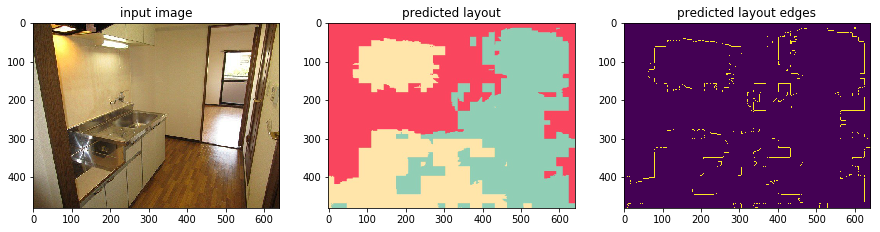

148.jpg


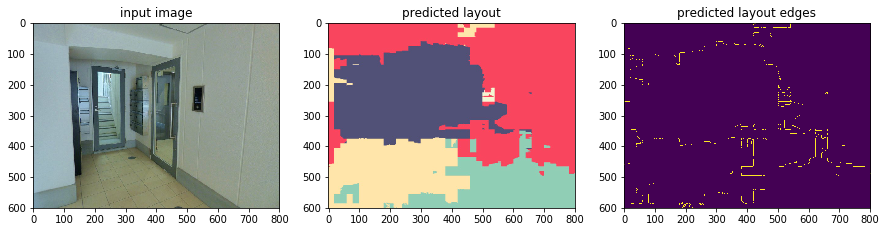

1.jpg


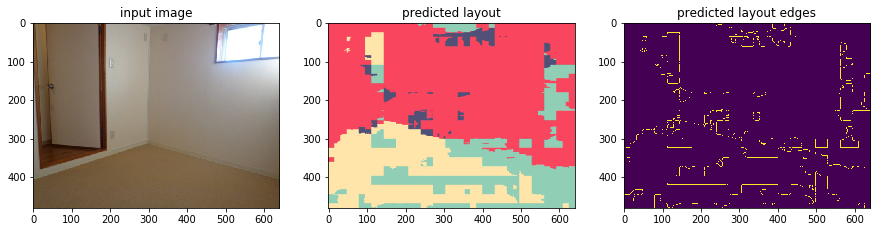

125.jpg


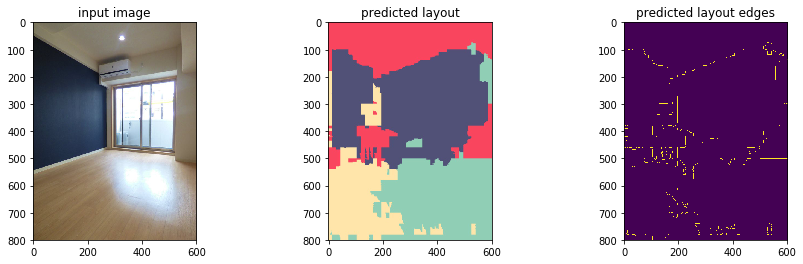

107.jpg


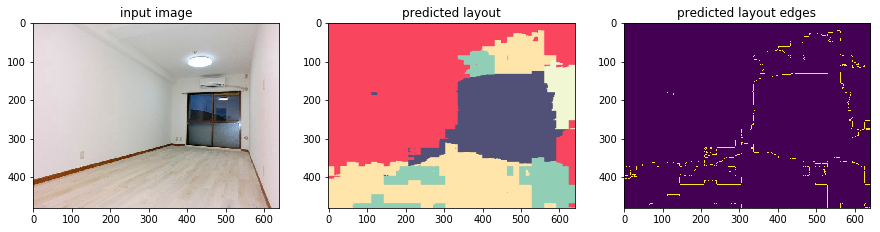

171.jpg


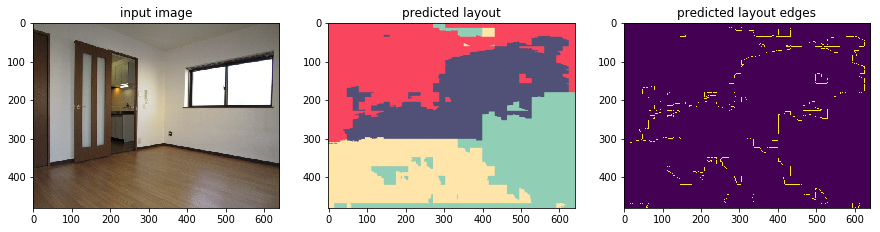

115.jpg


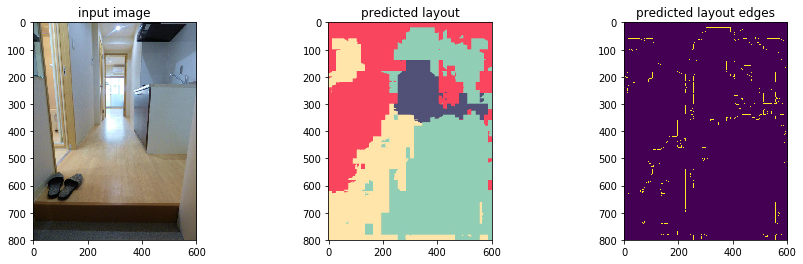

229.jpg


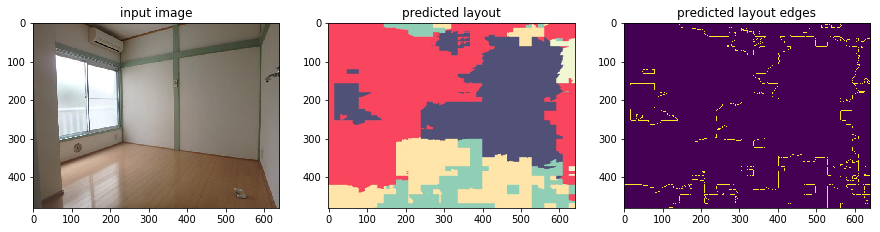

247.jpg


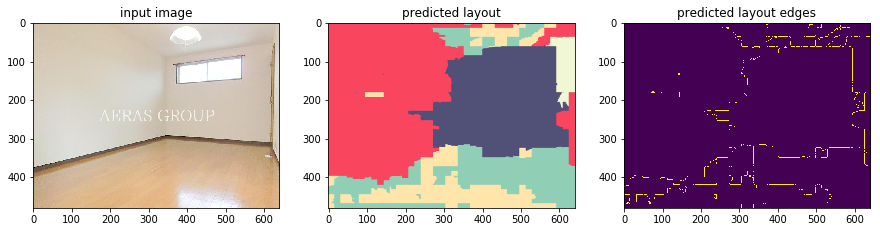

232.jpg


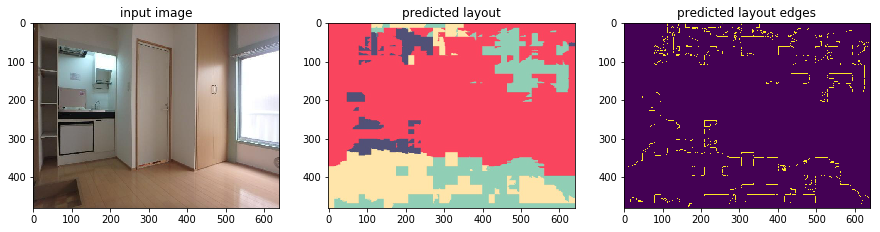

284.jpg


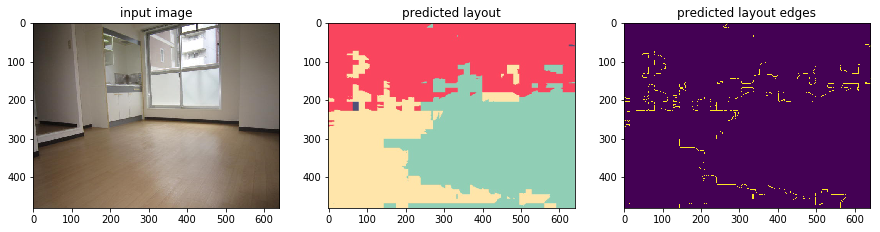

117.jpg


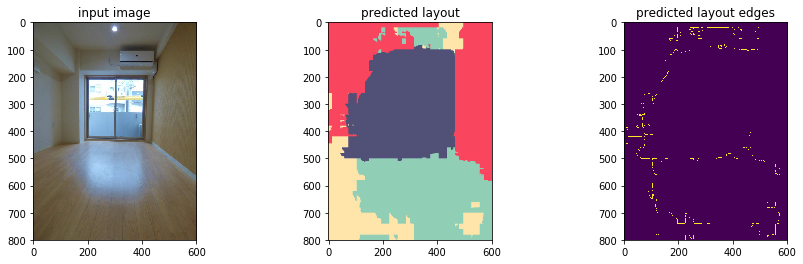

170.jpg


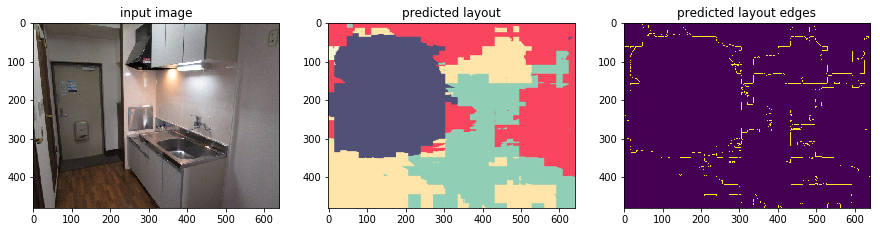

293.jpg


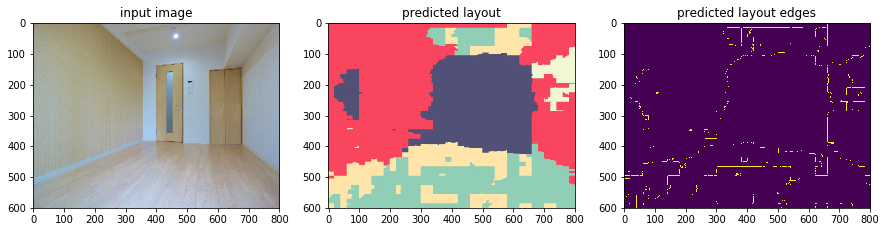

248.jpg


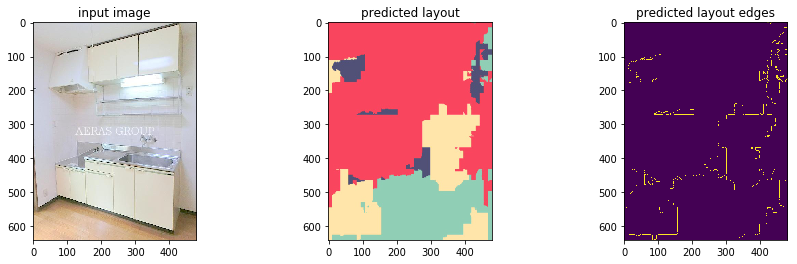

163.jpg


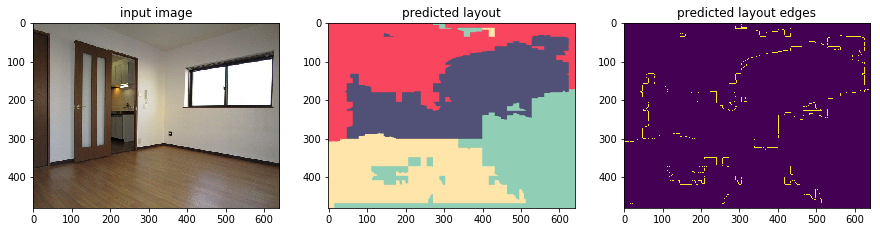

123.jpg


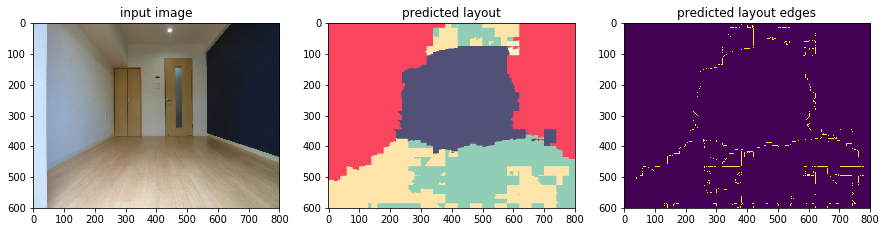

28.jpg


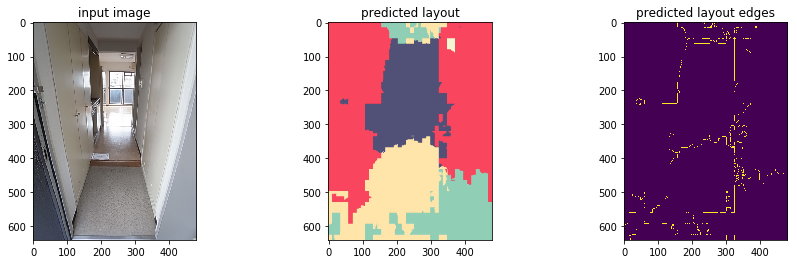

30.jpg


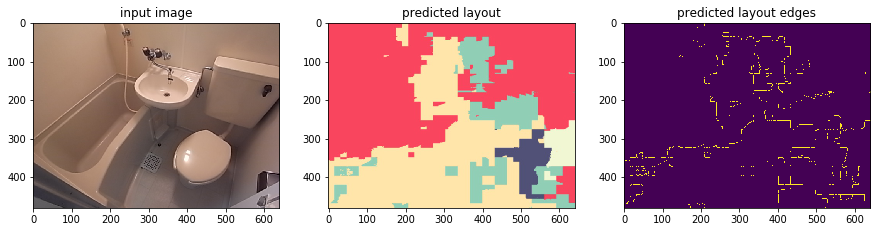

350.jpg


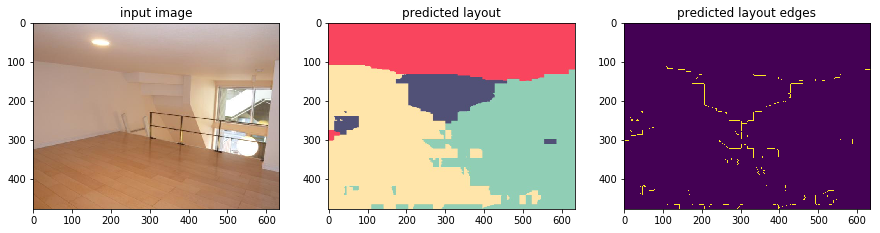

29.jpg


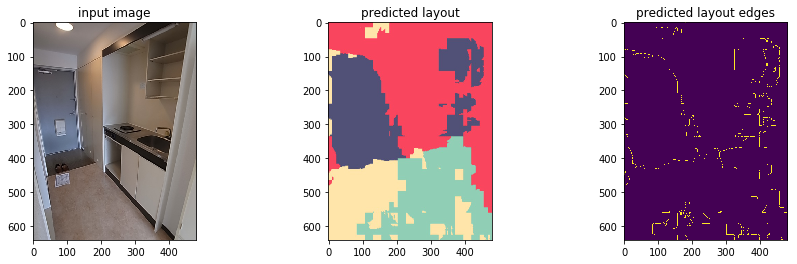

357.jpg


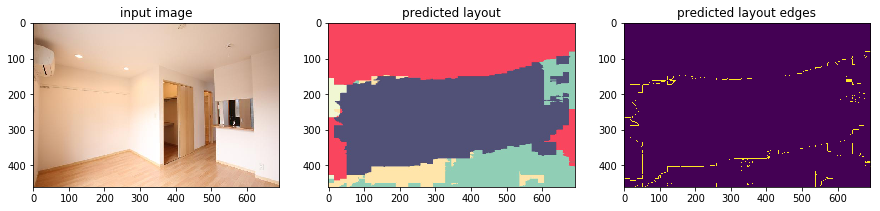

250.jpg


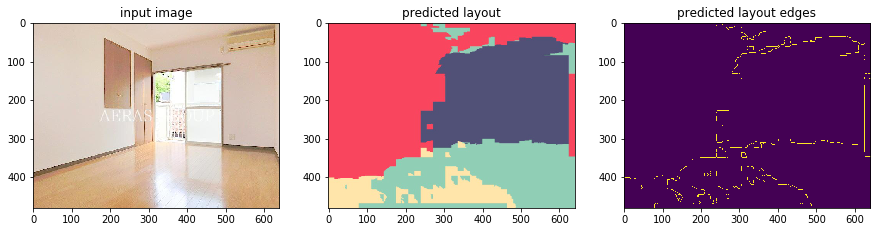

39.jpg


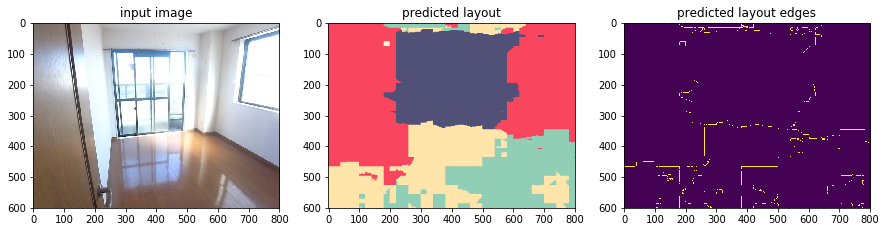

31.jpg


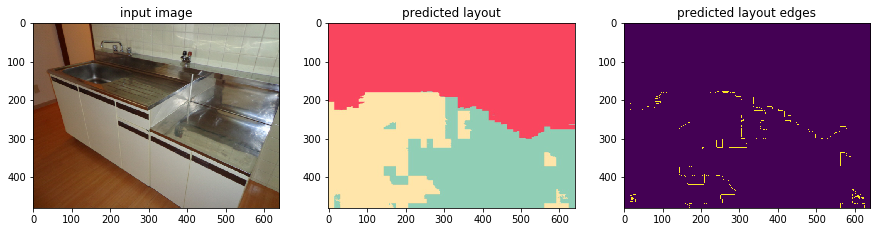

118.jpg


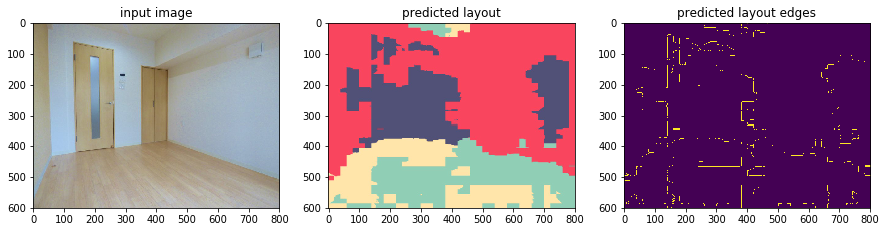

40.jpg


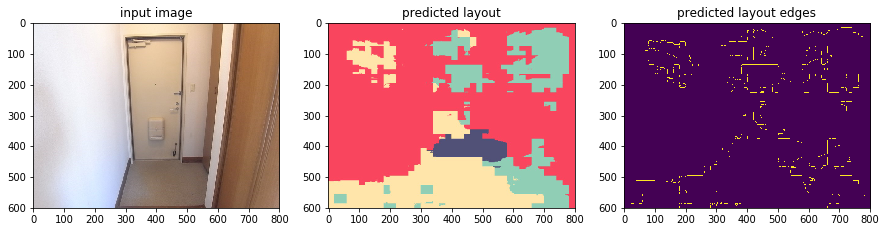

352.jpg


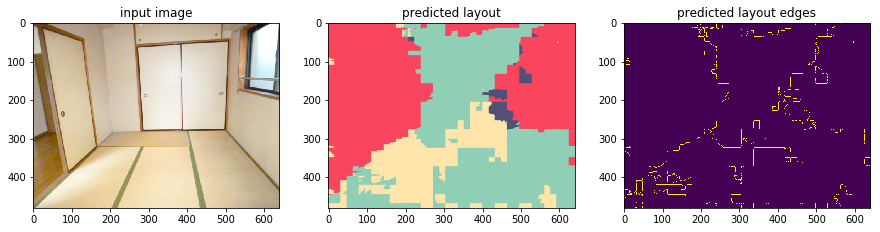

338.jpg


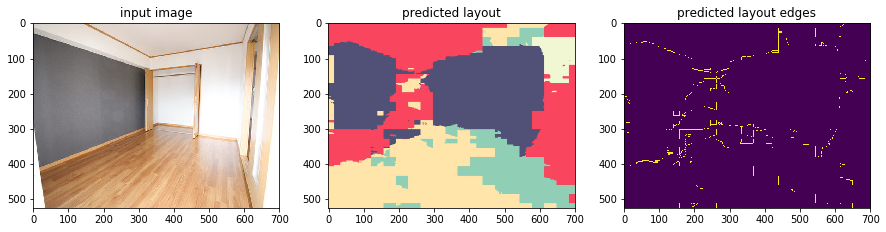

408.jpg


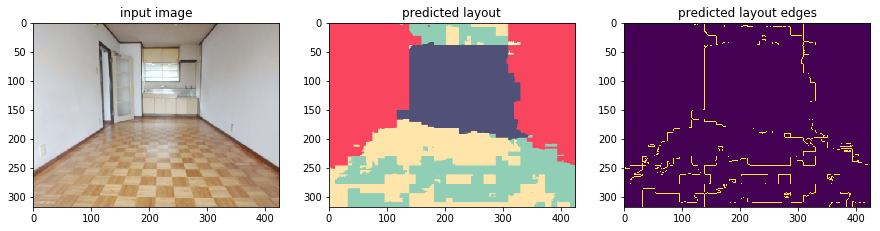

405.jpg


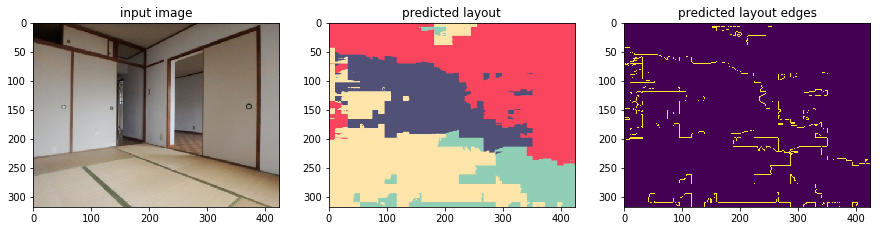

435.jpg


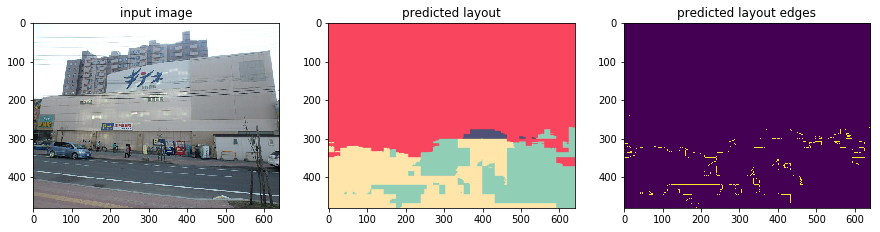

413.jpg


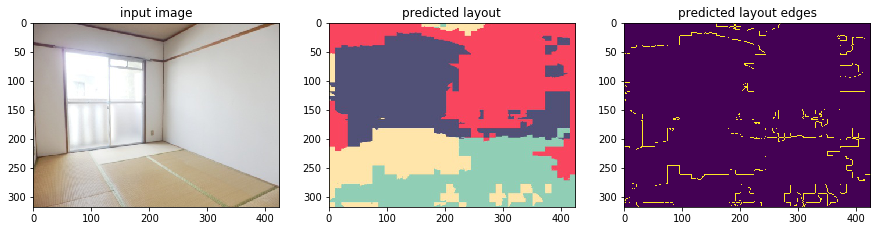

409.jpg


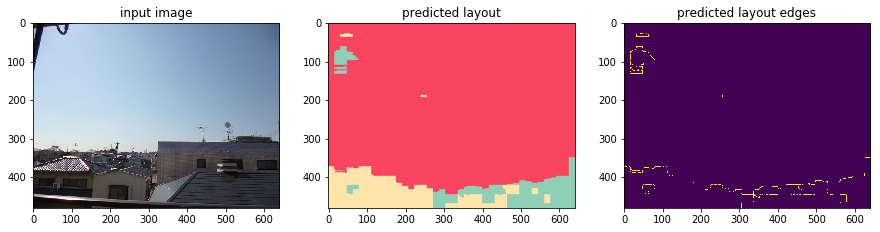

359.jpg


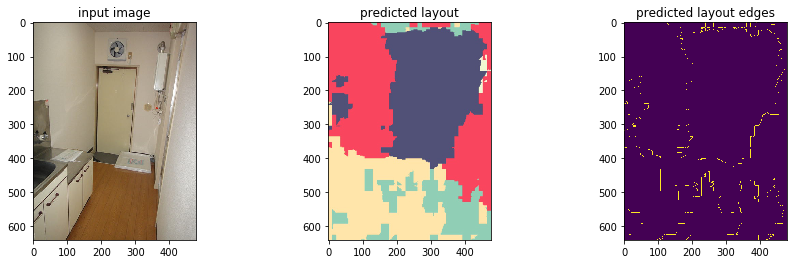

480.jpg


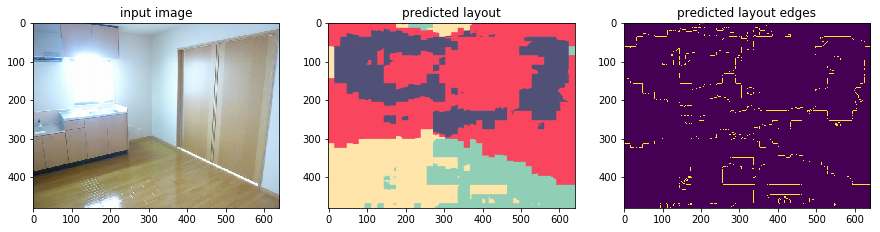

35.jpg


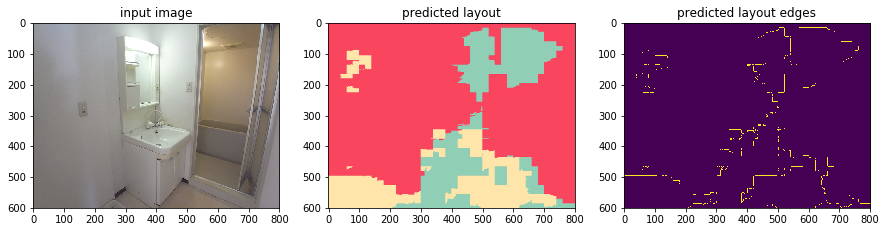

36.jpg


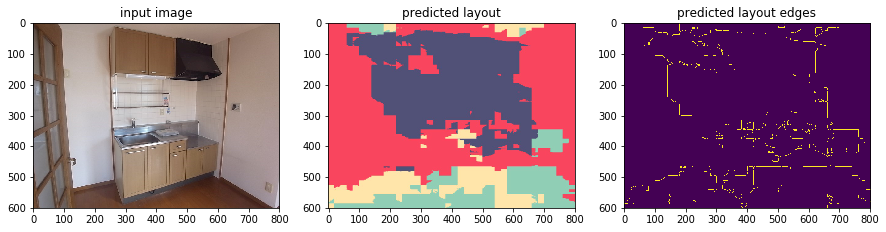

436.jpg


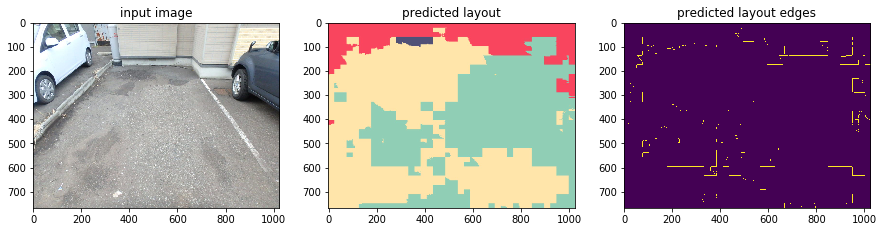

438.jpg


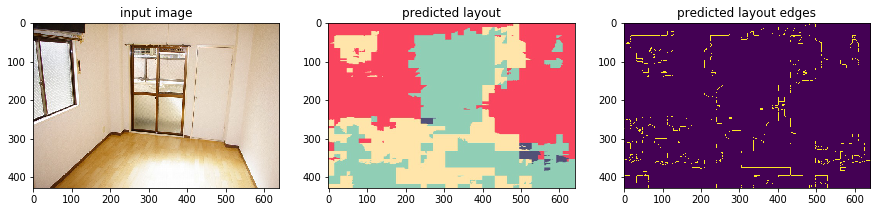

37.jpg


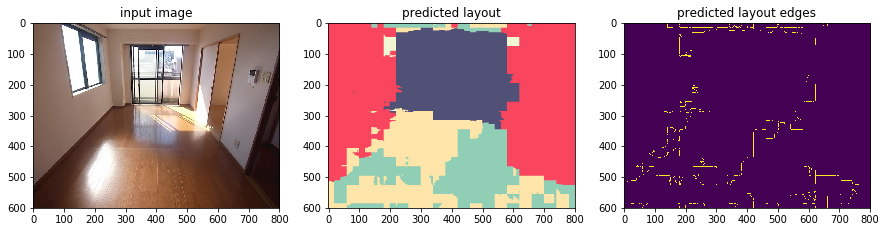

469.jpg


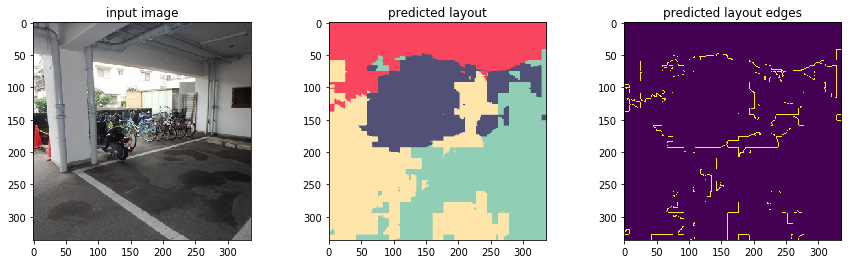

44.jpg


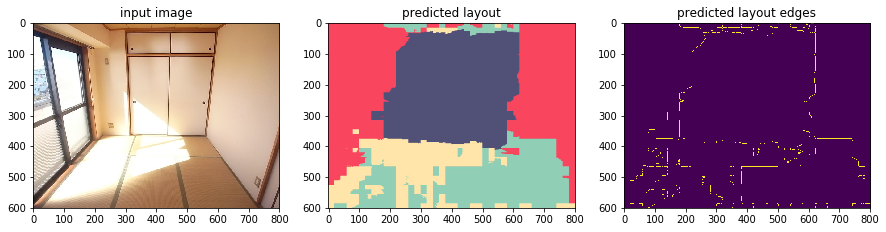

465.jpg


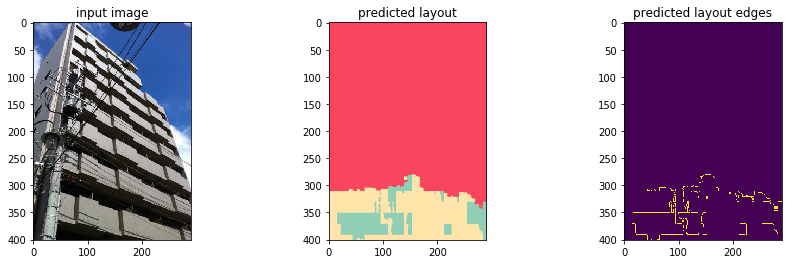

61.jpg


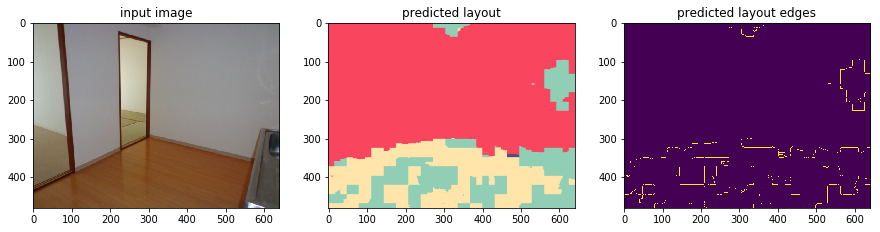

70.jpg


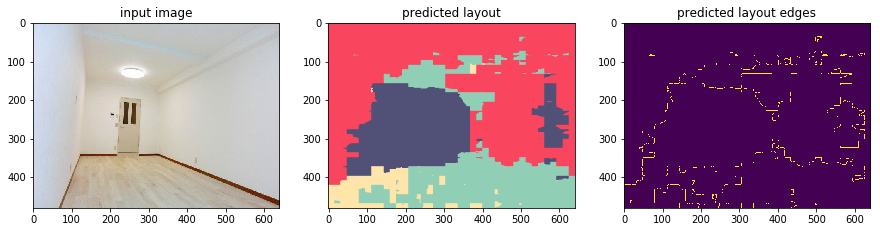

55.jpg


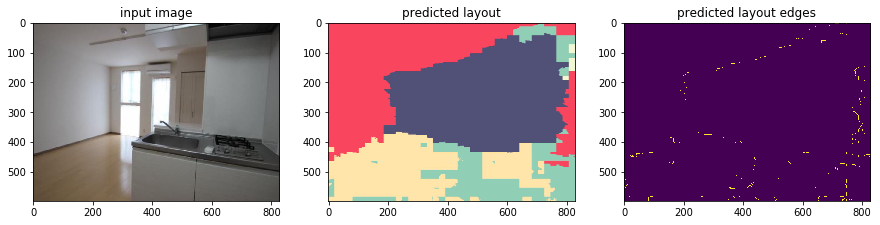

63.jpg


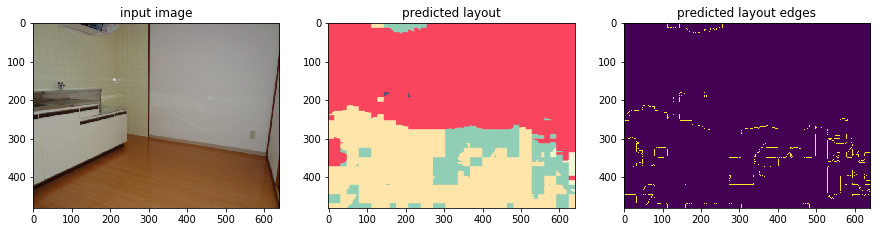

65.jpg


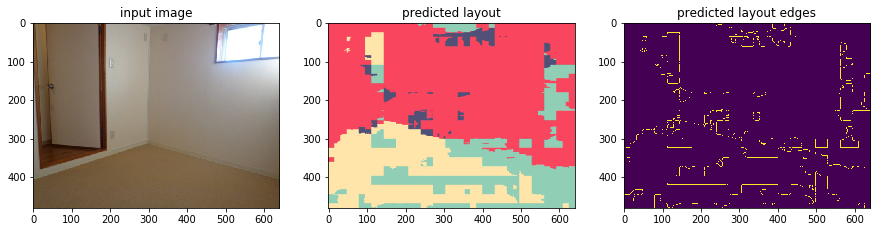

8.jpg


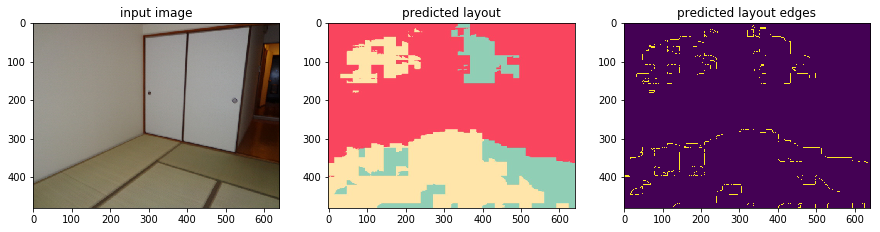

64.jpg


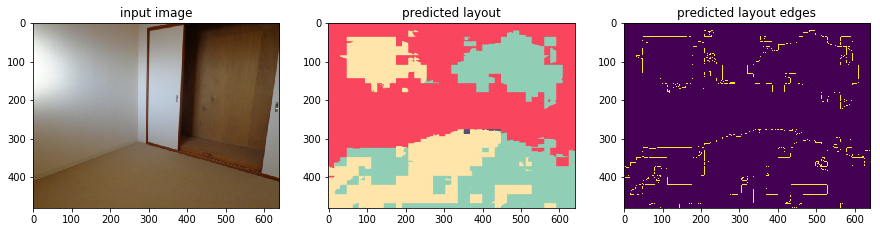

76.jpg


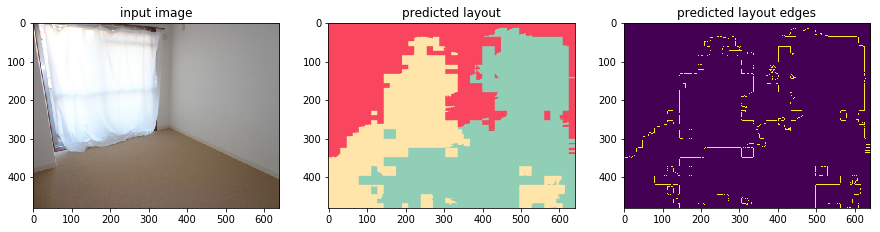

83.jpg


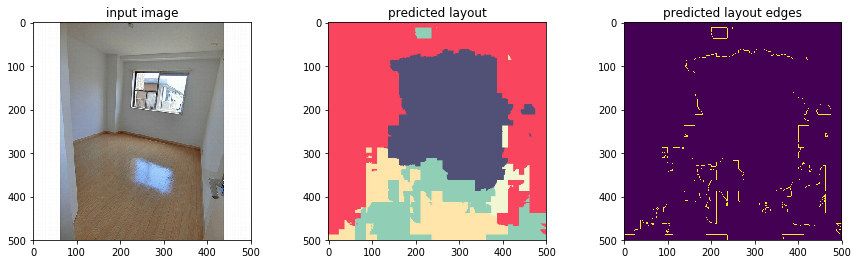

62.jpg


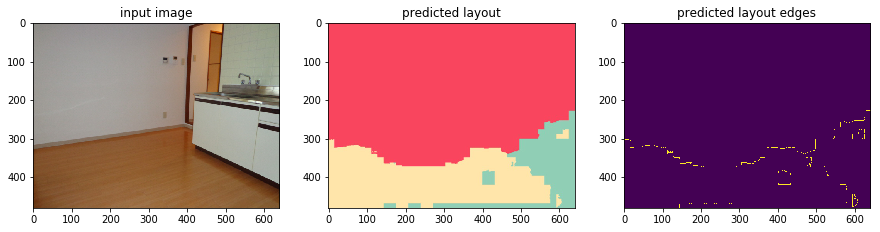

77.jpg


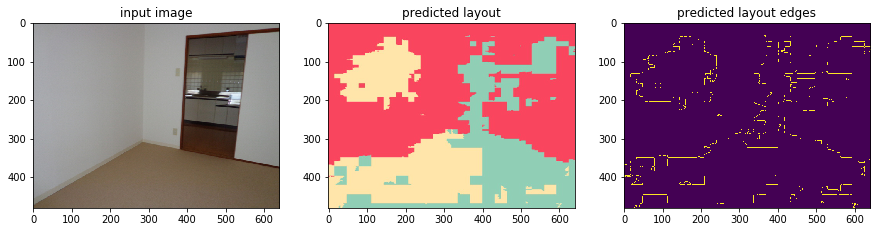

6.jpg


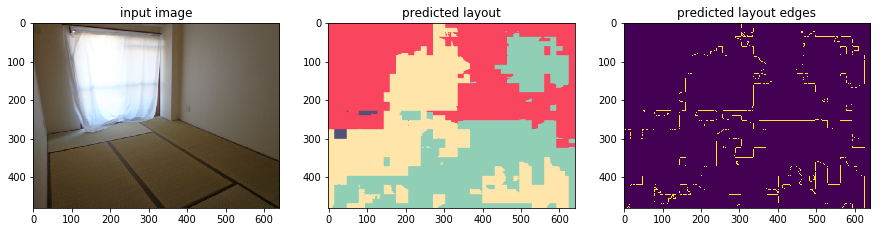

85.jpg


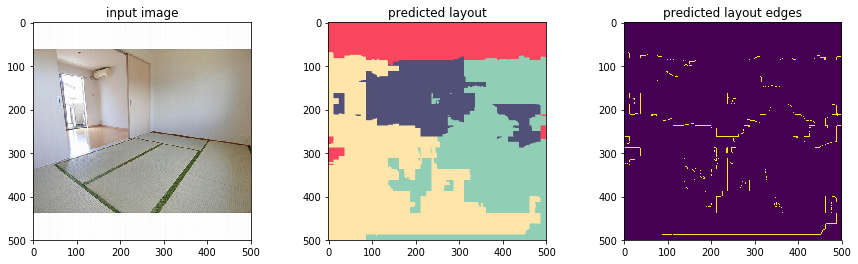

95.jpg


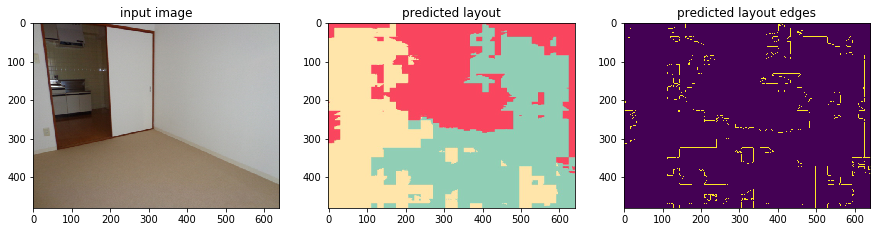

87.jpg


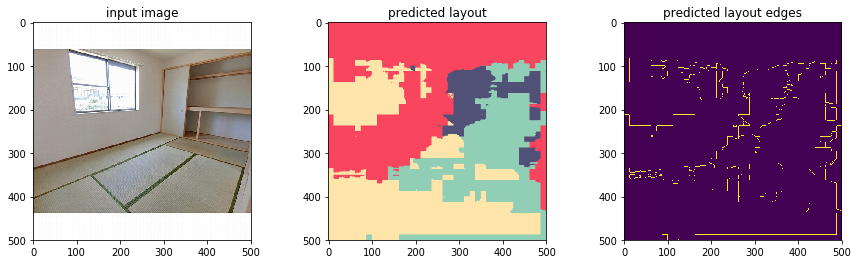

93.jpg


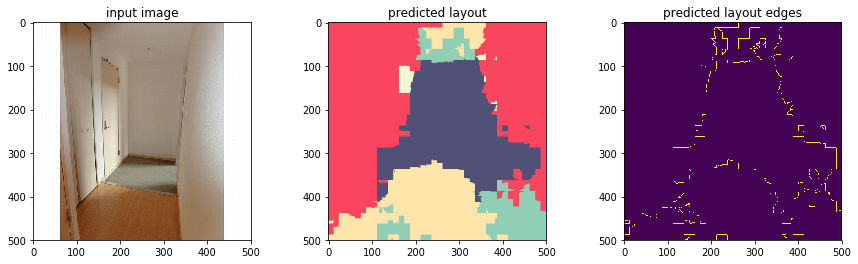

In [3]:
# homes
# --l2_factor 5  --edge_factor 50
test_input = Path('../data/homes/test_input')
test_output = Path('../data/homes/test_output')
show_imgs(test_input, test_output)

7810.jpg


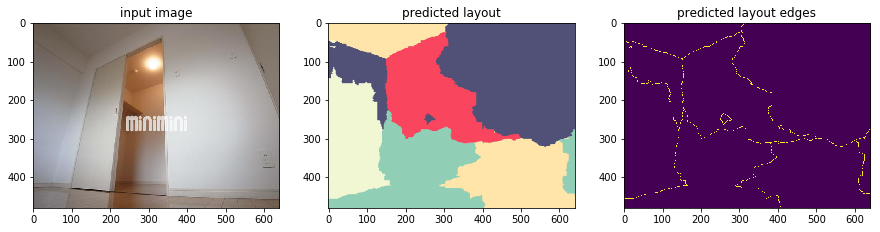

7884.jpg


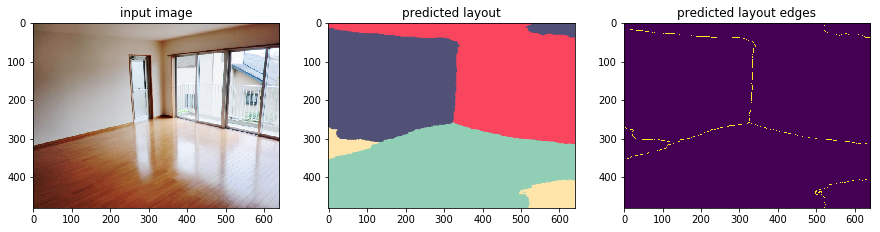

7945.jpg


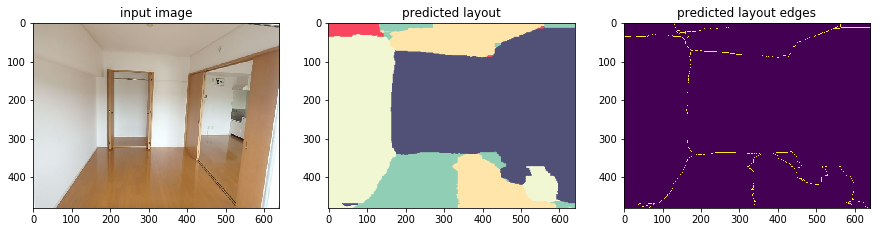

8062.jpg


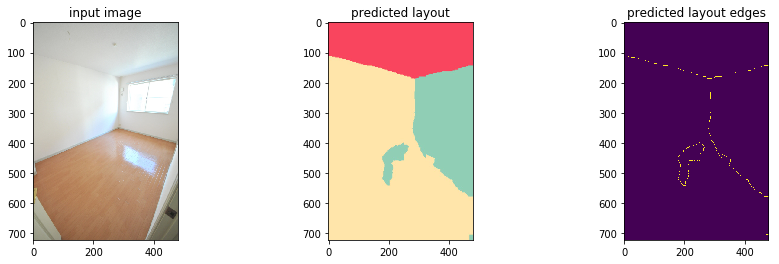

8149.jpg


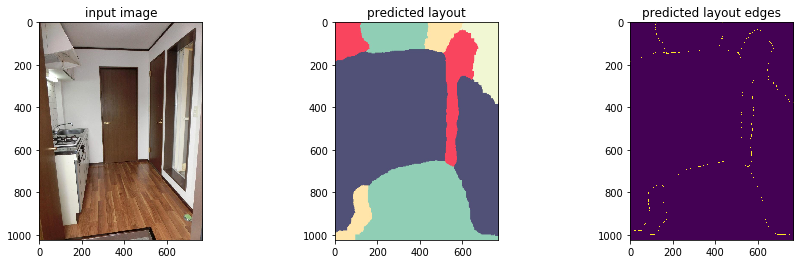

8261.jpg


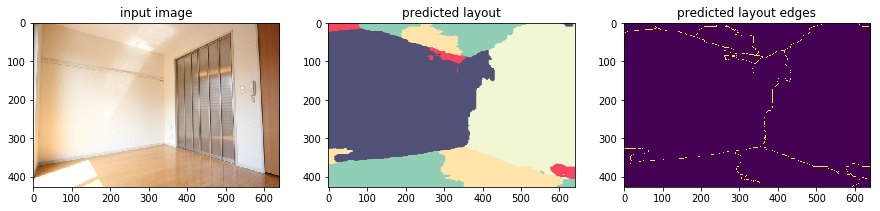

8264.jpg


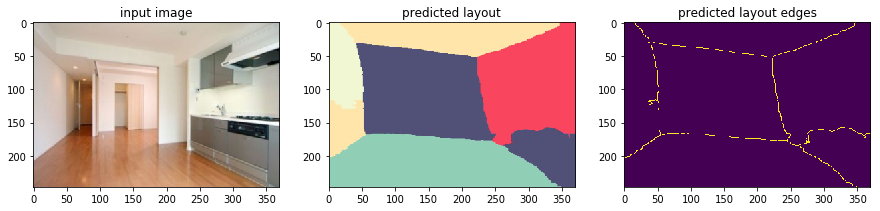

8281.jpg


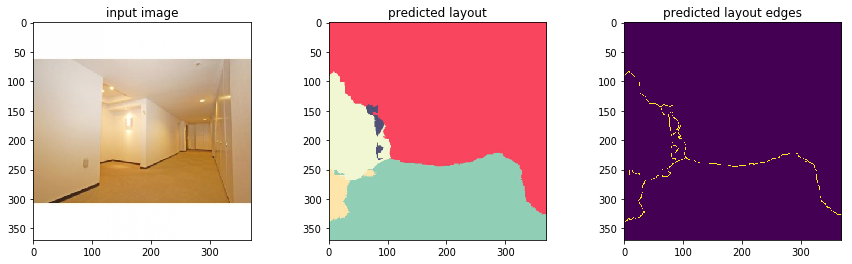

8395.jpg


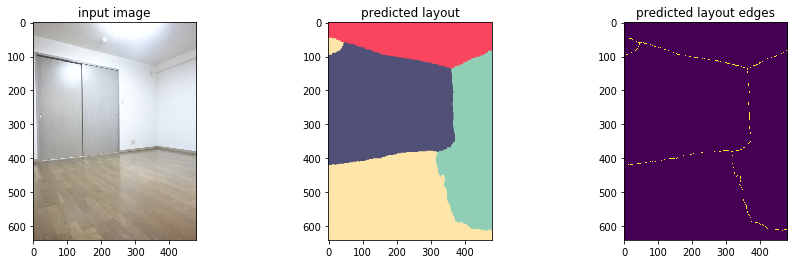

8458.jpg


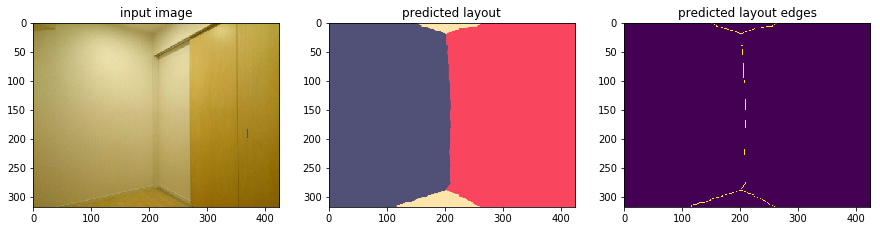

8463.jpg


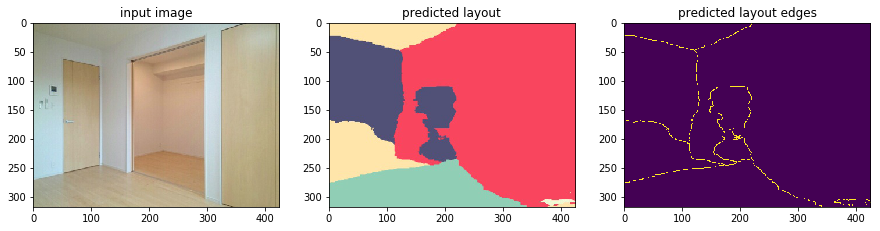

8569.jpg


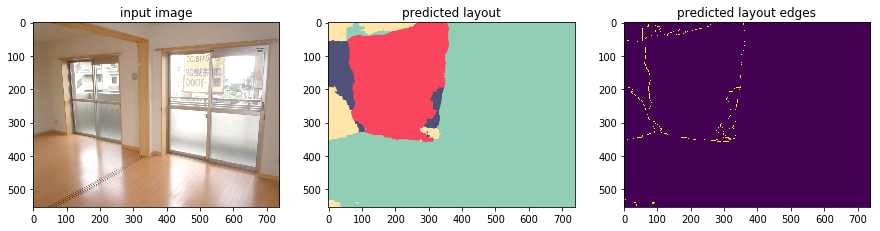

8592.jpg


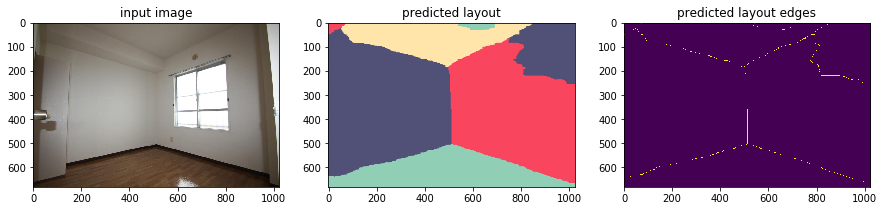

8646.jpg


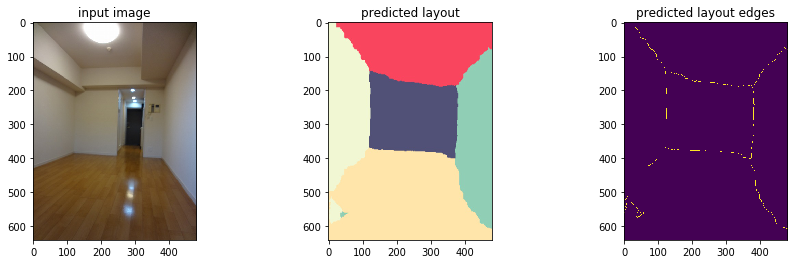

8721.jpg


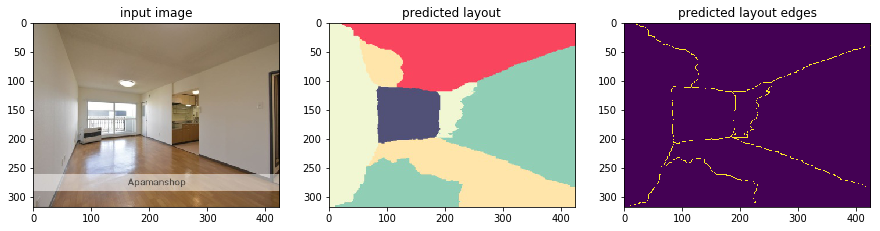

8725.jpg


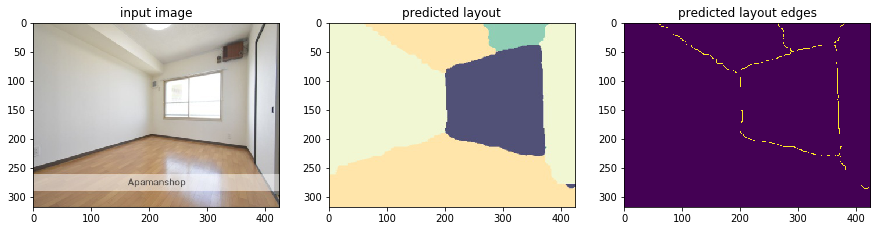

8850.jpg


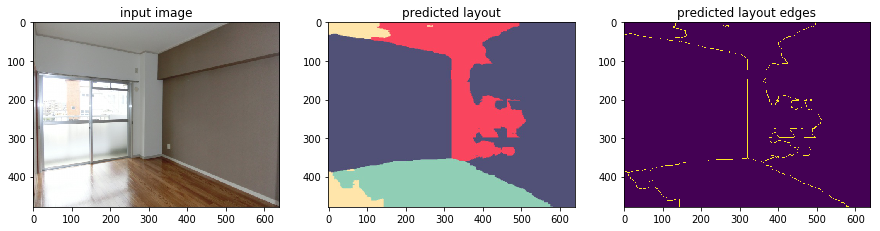

8865.jpg


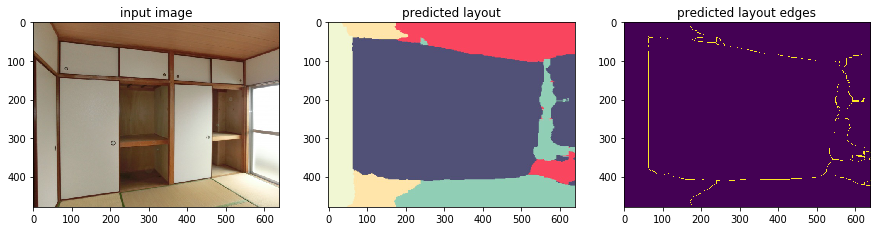

8946.jpg


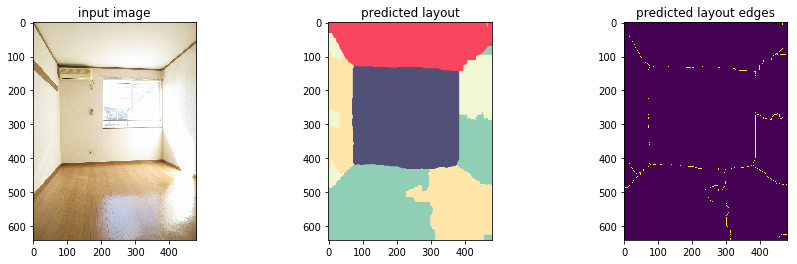

8998.jpg


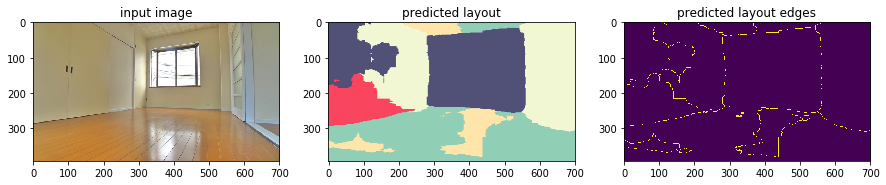

8999.jpg


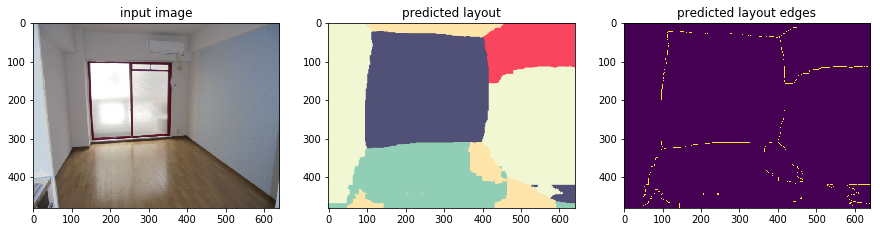

9044.jpg


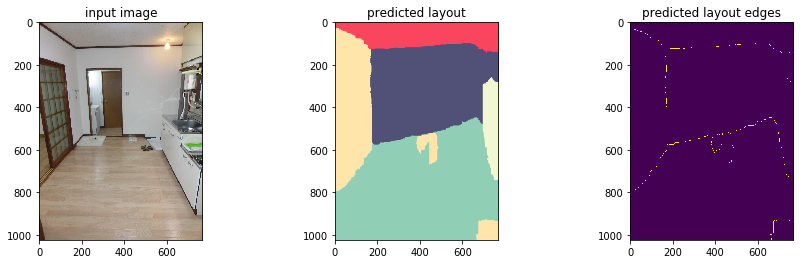

9069.jpg


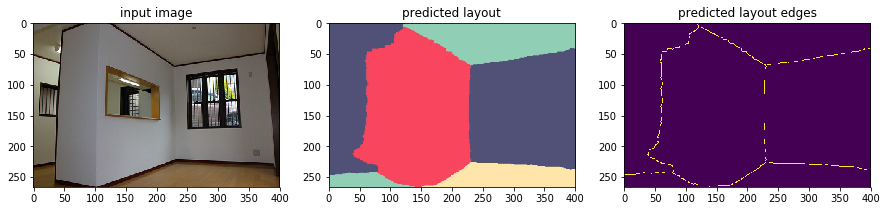

9070.jpg


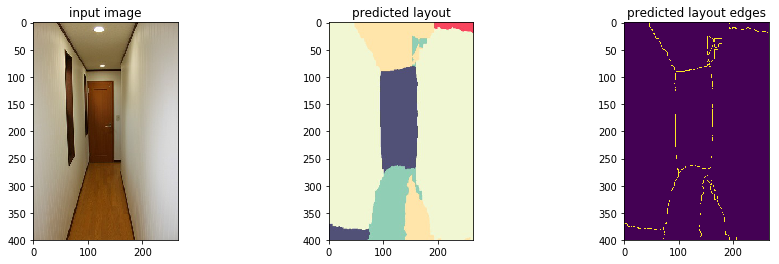

9154.jpg


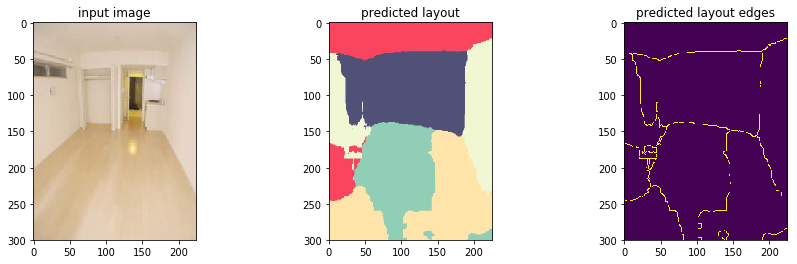

9157.jpg


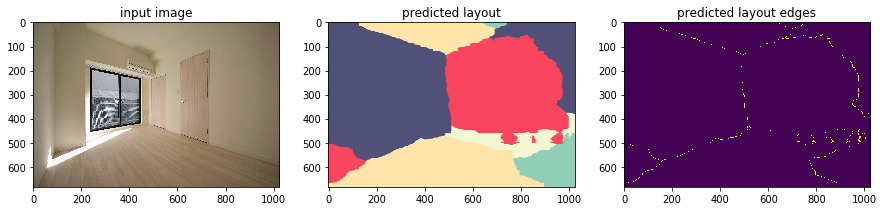

9178.jpg


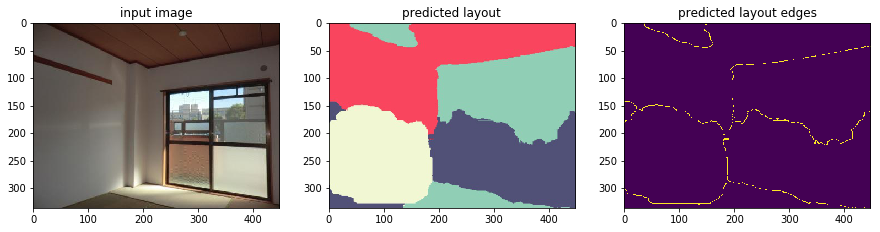

9290.jpg


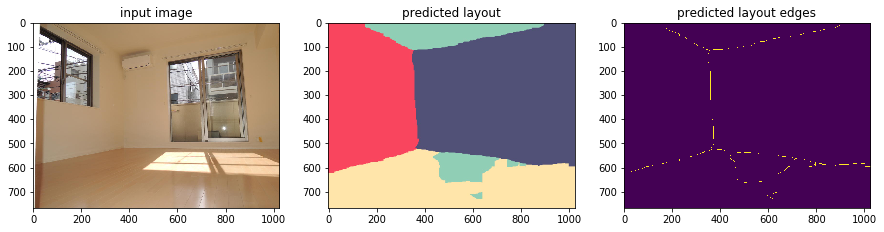

9291.jpg


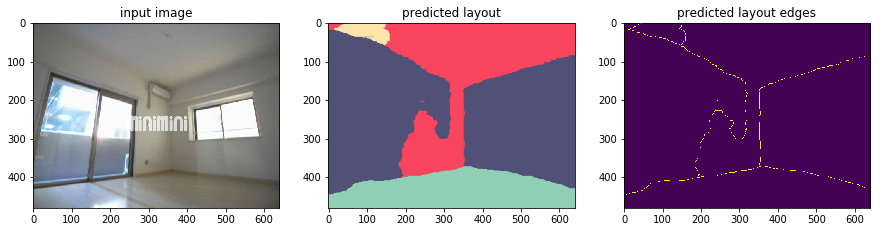

9314.jpg


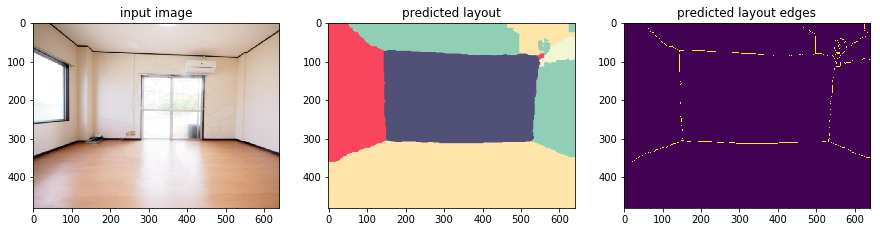

9315.jpg


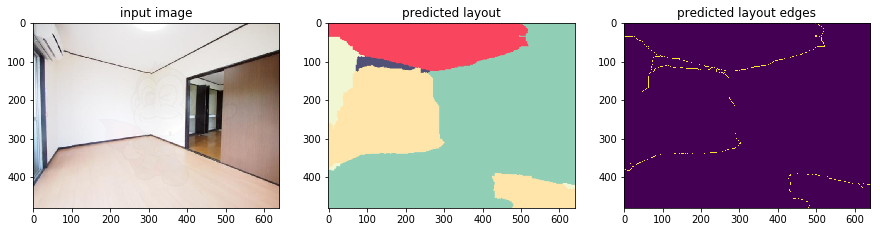

9334.jpg


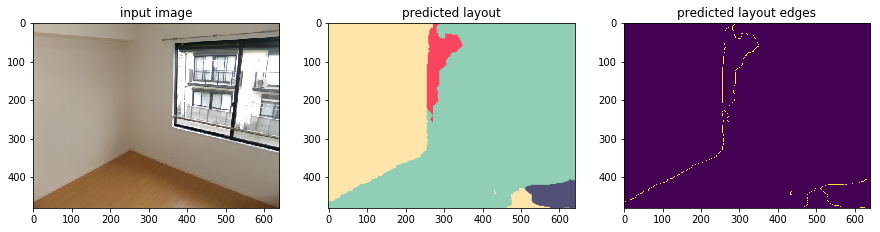

9372.jpg


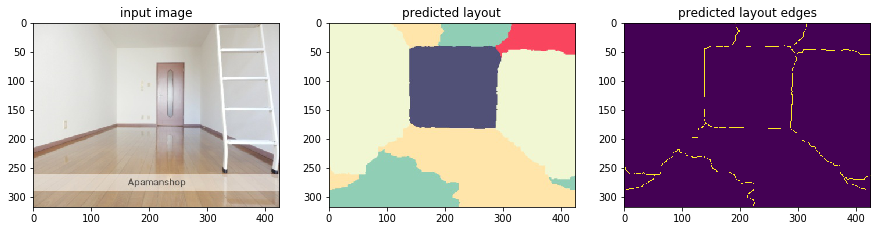

9431.jpg


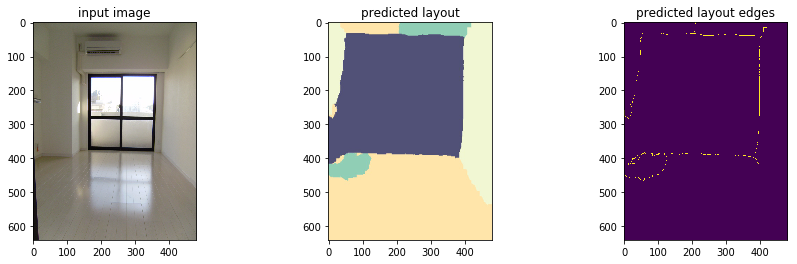

9489.jpg


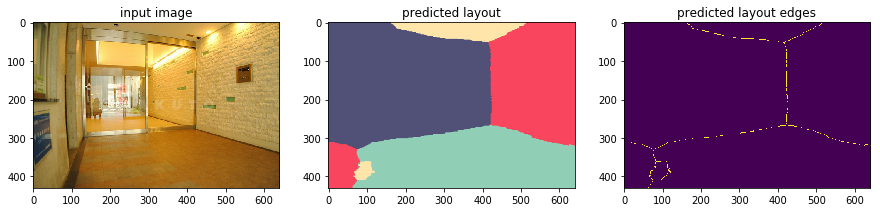

9505.jpg


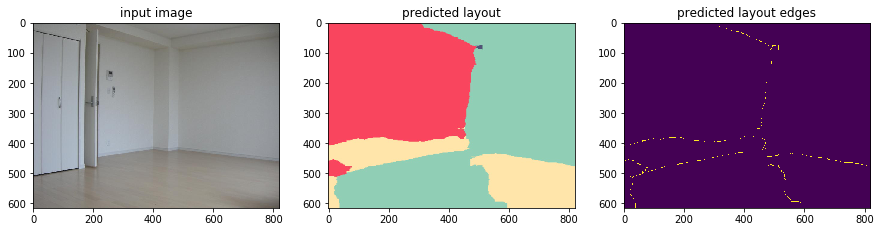

9565.jpg


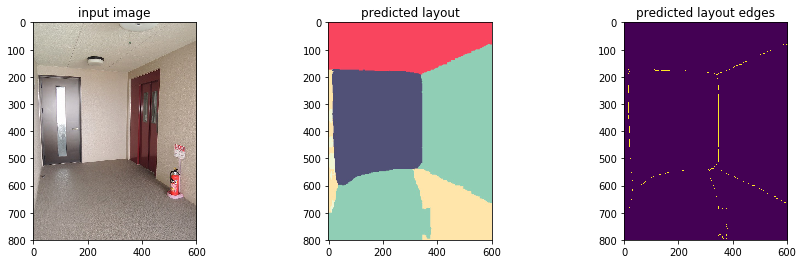

9568.jpg


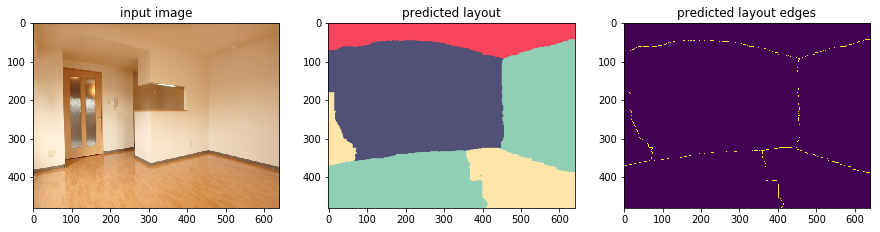

9569.jpg


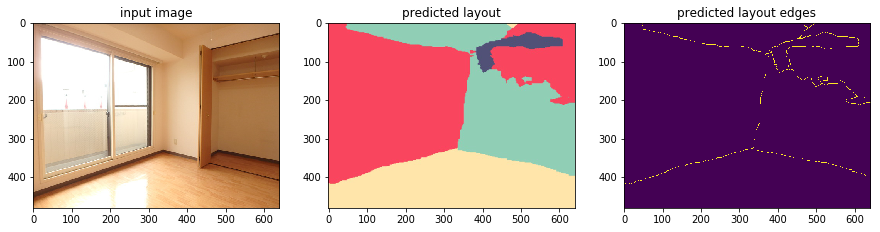

9618.jpg


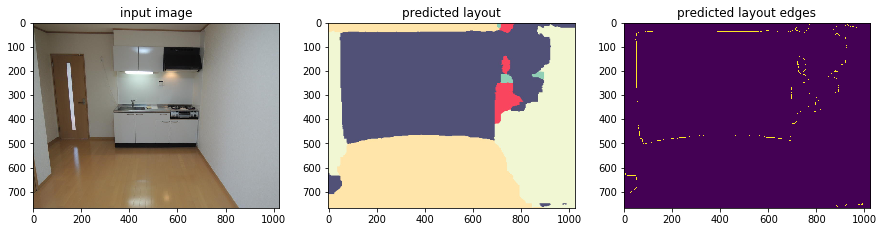

9652.jpg


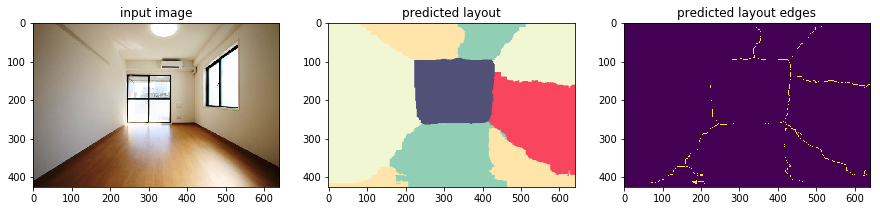

9668.jpg


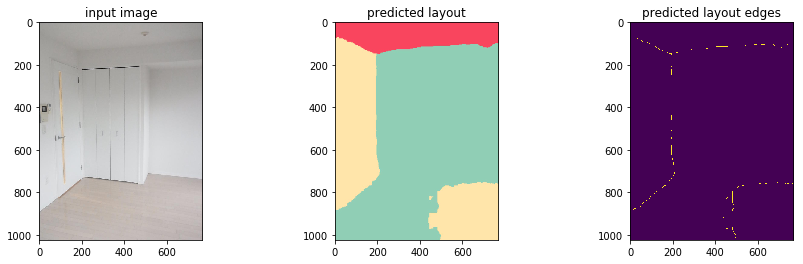

9701.jpg


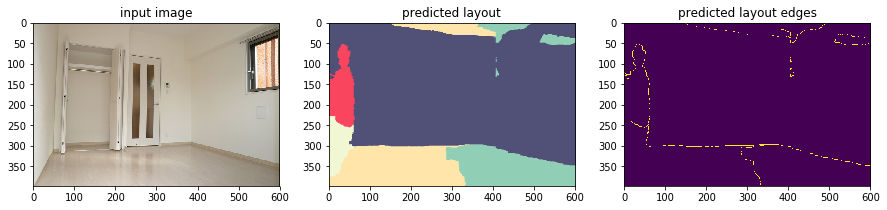

9717.jpg


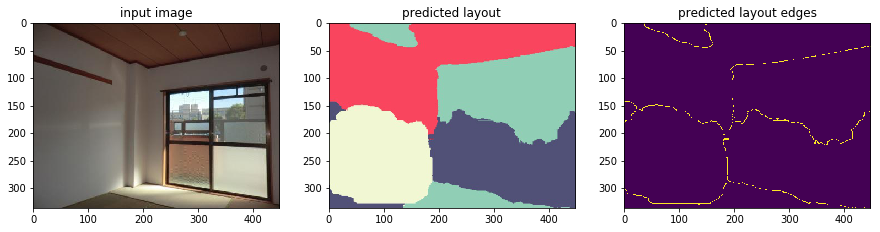

9719.jpg


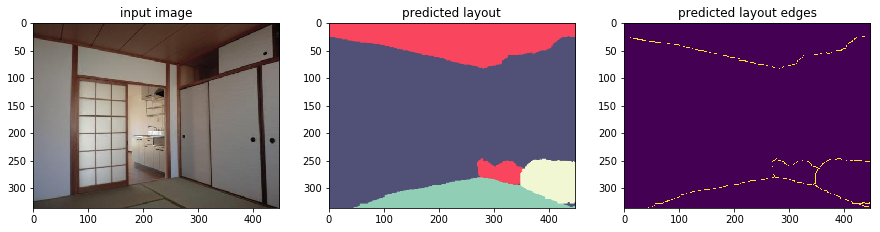

9740.jpg


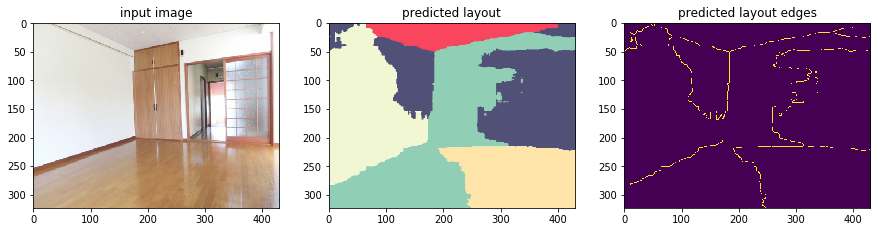

9762.jpg


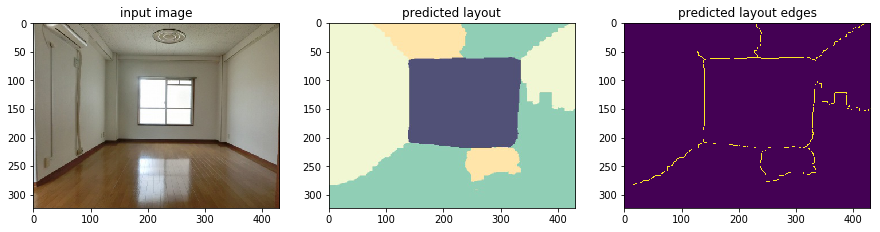

9763.jpg


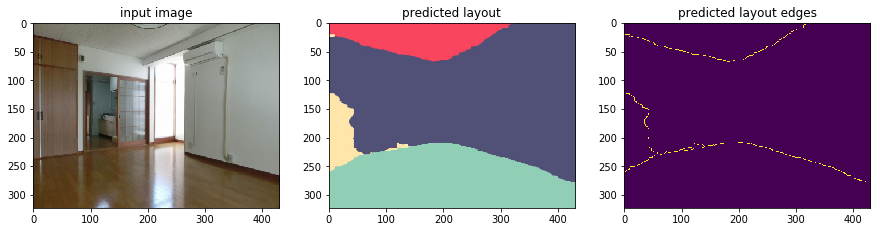

9769.jpg


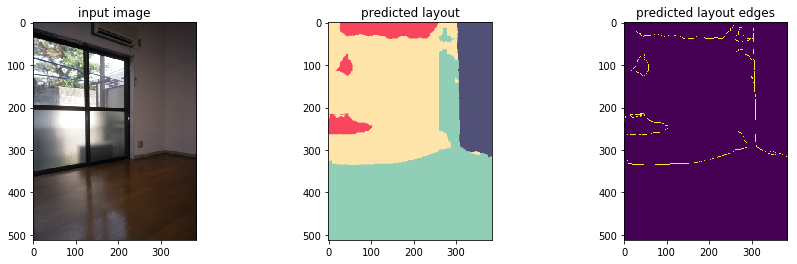

9801.jpg


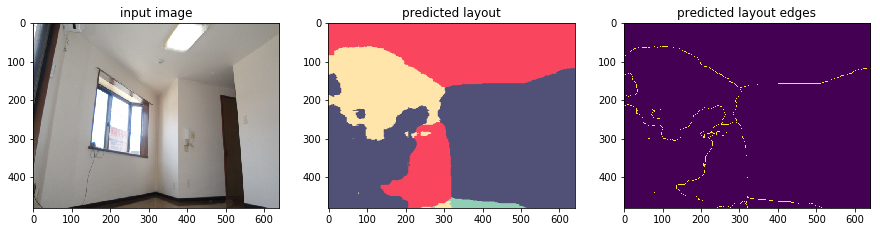

9850.jpg


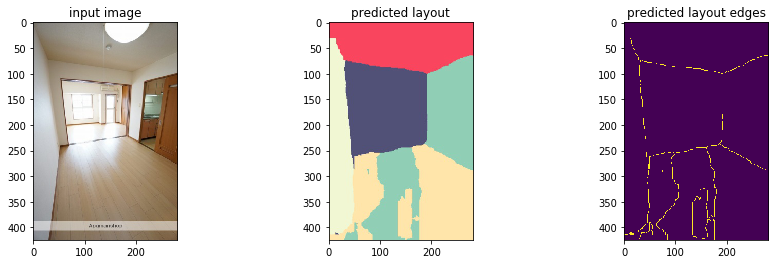

9905.jpg


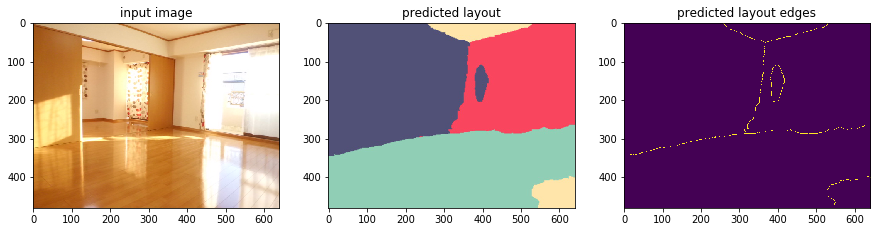

9910.jpg


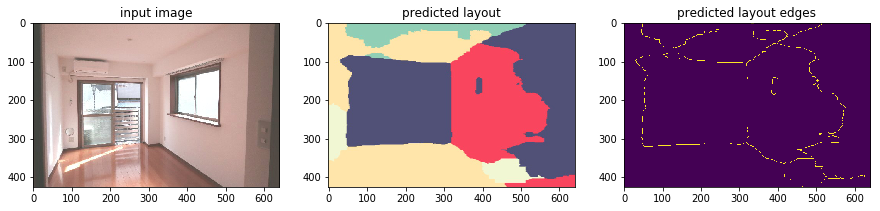

9943.jpg


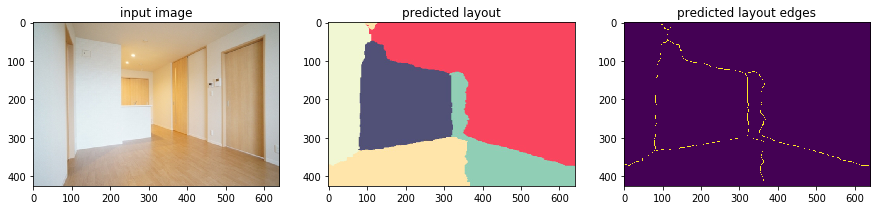

9944.jpg


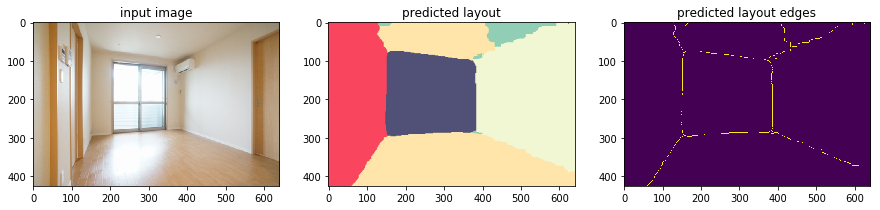

9972.jpg


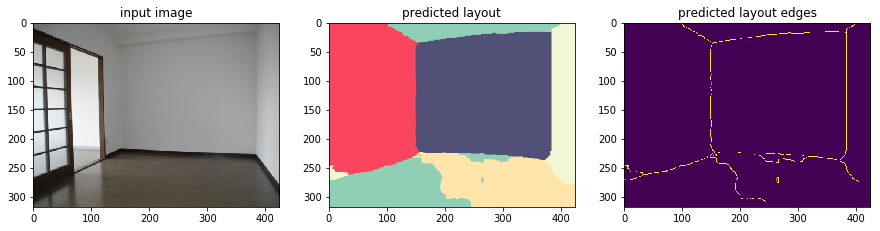

9985.jpg


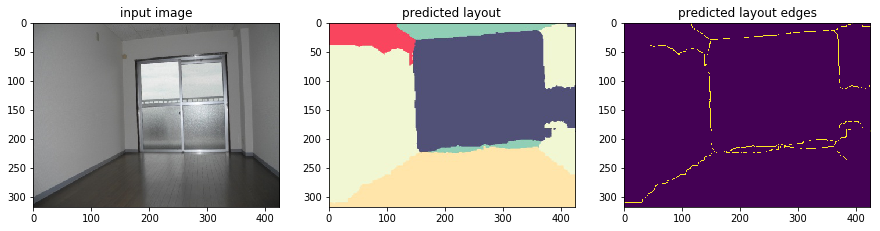

9987.jpg


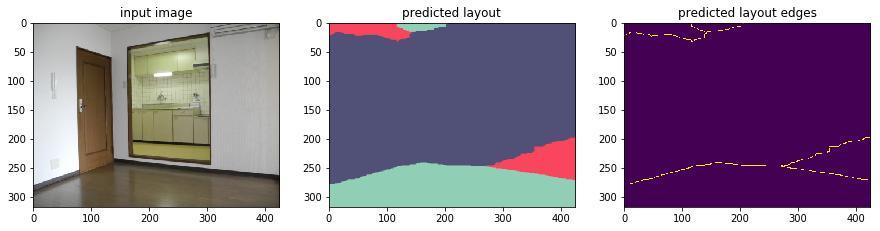

9990.jpg


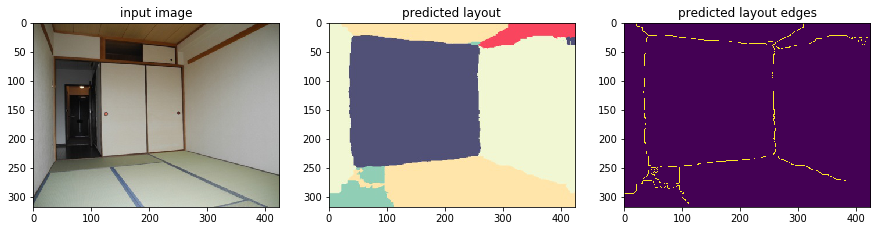

9992.jpg


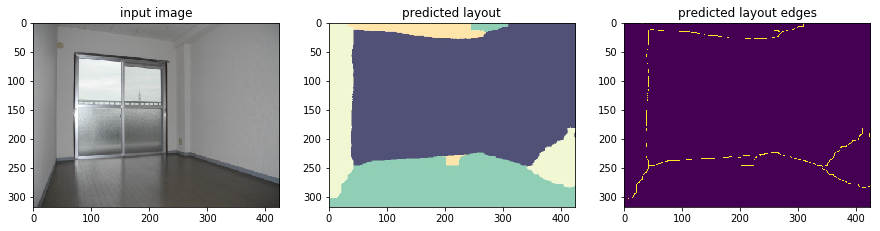

In [107]:
# homes2
# --l2_factor 5  --edge_factor 50　
test_input = Path('../data/homes2/test_input')
test_output = Path('../data/homes2/test_output')
show_imgs(test_input, test_output)

In [40]:
def post_process(img_no):
    img_path = str(Path('../data/homes/test_input') / '{}.jpg'.format(img_no))
    layout_path = str(Path('../data/homes/test_output') / '{}.jpg'.format(img_no))
    mask_path = str(Path('../Mask_RCNN/samples/homes/mask_results') / 'mask_{}.jpg'.format(img_no))
    
    ori_img = cv2.imread(img_path)
    img = cv2.imread(layout_path)
    mask_img = cv2.imread(mask_path)[:, :, ::-1]
    
    plt.figure(figsize=(15, 8))

    # 入力画像
    ori_img = cv2.cvtColor(ori_img, cv2.COLOR_BGR2RGB)
    plt.subplot(231)
    plt.imshow(ori_img)
    plt.title('input image')

    # layout予測
    plt.subplot(232)
    plt.imshow(img)
    plt.title('layout prediction')

    # 二値化
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) # convert to grayscale
    blur = cv2.blur(gray, (3, 3)) # blur the image
    ret, thresh = cv2.threshold(blur, 100, 255, cv2.THRESH_BINARY)
    thresh = np.invert(thresh)

    plt.subplot(233)
    plt.imshow(thresh)
    plt.title('binary + front filtering')

    # 輪郭線
    im2, contours, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    plt.subplot(234)
    con_img = cv2.drawContours(img.copy(), contours, -1, (255,0,0), 10)
    plt.imshow(con_img)
    plt.title('contours')

    # 凸包
    hulls = []
    for c in contours:
        hulls.append(cv2.convexHull(c, False))
    idx = np.argmax([len(h) for h in hulls])
    plt.subplot(235)
    hull_img = cv2.drawContours(img.copy(), hulls, idx, (255,0,0), 10)
    hull_img = cv2.drawContours(hull_img, hulls[idx], -1, (0, 255, 0), 10)
    plt.imshow(hull_img)
    xy = hulls[idx].squeeze()
    plt.title('largest convex hull: {} points'.format(len(xy)))
    
    
    # 近似四辺形 (type 0)
    plt.subplot(236)
    plt.title('quad approximation')
    def get_nearest_p(anchor_p):
        return np.argmin([hypot(p[0] - anchor_p[0], p[1] - anchor_p[1]) for p in xy])
    idx_ul = get_nearest_p([0, 0])
    idx_bl = get_nearest_p([0, img.shape[0]])
    idx_ur = get_nearest_p([img.shape[1], 0])
    idx_br = get_nearest_p([img.shape[1], img.shape[0]])
    quad_approx = np.asarray([xy[idx_ul], xy[idx_bl], xy[idx_br], xy[idx_ur]])
    quad_img = cv2.drawContours(ori_img.copy(), [quad_approx], -1, (255,0,0), 10)
    quad_img = cv2.drawContours(quad_img, quad_approx.reshape(4, 1, 2), -1, (0, 255, 0), 10)
    plt.imshow(quad_img)
    
    '''
    # 近似多辺形 (type 5)
    plt.subplot(236)
    poly_approx = cv2.approxPolyDP(xy, 25, True)
    poly_img = cv2.drawContours(mask_img.copy(), [poly_approx], -1, (255,0,0), 10)
    poly_img = cv2.drawContours(poly_img, poly_approx, -1, (0, 255, 0), 10)
    plt.imshow(poly_img)
    plt.title('polygon approximation: {} points'.format(len(poly_approx)))
    cv2.imwrite(os.path.join('../Mask_RCNN/samples/homes/mask_results', 
                             'poly_mask_%s.jpg') % img_no, poly_img[:, :, ::-1])
    '''

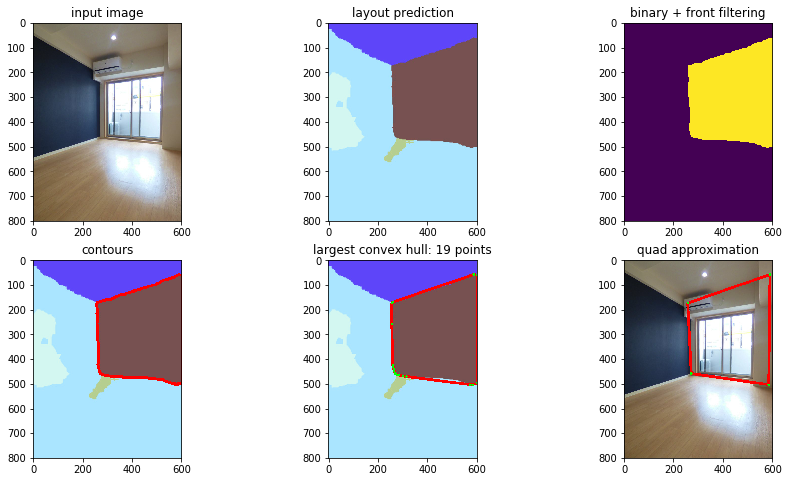

In [41]:
# 357, 163, 107, 125
post_process(125)

In [112]:
def compute_height(img_no):
    img_path = str(Path('../data/homes2/test_input') / '{}.jpg'.format(img_no))
    layout_path = str(Path('../data/homes2/test_output') / '{}.jpg'.format(img_no))
    mask_path = str(Path('../Mask_RCNN/samples/homes/mask_results') / 'mask_{}.jpg'.format(img_no))
    
    img_ori = cv2.imread(img_path)
    img_layout = cv2.imread(layout_path)
    img_mask = cv2.imread(mask_path)[:, :, ::-1]
    
    plt.figure(figsize=(15, 8))

    # 入力画像
    img_ori = cv2.cvtColor(img_ori, cv2.COLOR_BGR2RGB)
    plt.subplot(131)
    plt.imshow(img_ori)
    plt.title('input image')

    def approx(img):
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) # convert to grayscale
        blur = cv2.blur(gray, (3, 3)) # blur the image
        ret, thresh = cv2.threshold(blur, 100, 255, cv2.THRESH_BINARY)
        thresh = np.invert(thresh)
        _, contours, _ = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        hulls = []
        for c in contours:
            hulls.append(cv2.convexHull(c, False))
        idx = np.argmax([len(h) for h in hulls])
        xy = hulls[idx].squeeze()
        
        def get_nearest_p(anchor_p):
            return np.argmin([hypot(p[0] - anchor_p[0], p[1] - anchor_p[1]) for p in xy])
        idx_ul = get_nearest_p([0, 0])
        idx_bl = get_nearest_p([0, img.shape[0]])
        idx_ur = get_nearest_p([img.shape[1], 0])
        idx_br = get_nearest_p([img.shape[1], img.shape[0]])
        quad_approx = np.asarray([xy[idx_ul], xy[idx_bl], xy[idx_br], xy[idx_ur]])
        
        return quad_approx
    
    # 近似四辺形を計算
    poly_lo = approx(img_layout)
    poly_m = approx(img_mask)
    
    # 高さ計算
    def intersection(o1, p1, o2, p2):
        x = o2 - o1
        d1 = p1 - o1
        d2 = p2 - o2
        
        cross = d1[0] * d2[1] - d1[1] * d2[0]
        if abs(cross) < 1e-8:
            return None

        t1 = (x[0] * d2[1] - x[1] * d2[0]) / cross
        r = o1 + d1 * t1
        return r.astype(int)
    
    up_in = intersection(poly_m[2], poly_m[3], poly_lo[0], poly_lo[3])
    bo_in = intersection(poly_m[2], poly_m[3], poly_lo[1], poly_lo[2])
    
    # 近似多辺形 (type 5)
    plt.subplot(132)
    poly_img = cv2.drawContours(img_ori.copy(), [poly_lo], -1, (255,0,0), 10)
    poly_img = cv2.drawContours(poly_img, poly_lo.reshape(4, 1, 2), -1, (0, 255, 0), 10)
    poly_img = cv2.drawContours(poly_img, [poly_m], -1, (0, 0, 255), 10)
    poly_img = cv2.drawContours(poly_img, poly_m.reshape(4, 1, 2), -1, (0, 255, 0), 10)
    
    # 交点
    poly_img == cv2.circle(poly_img, (up_in[0], up_in[1]), 5, (255, 255, 100), 5)
    poly_img == cv2.circle(poly_img, (bo_in[0], bo_in[1]), 5, (255, 255, 100), 5)
    plt.imshow(poly_img)
    plt.title('polygon approximation: {} points'.format(len(poly_lo)))
    #cv2.imwrite(os.path.join('../Mask_RCNN/samples/homes/mask_results', 'poly_mask_%s.jpg') % img_no, poly_img[:, :, ::-1])
    
    plt.subplot(133)
    poly_img == cv2.line(poly_img, (up_in[0], up_in[1]), (bo_in[0], bo_in[1]), (255, 255, 100), 5)
    plt.imshow(poly_img)
    plt.title('height of room')
    
    dist_height = hypot(up_in[0] - bo_in[0], up_in[1] - bo_in[1])
    dist_door = hypot(poly_m[2][0] - poly_m[3][0], poly_m[2][1] - poly_m[3][1])
    
    print('Height ratio is %.4f' % (dist_height / dist_door))
    print('Room height is %.2fmm if door height is 1830mm' % (1830 * dist_height / dist_door))

Height ratio is 1.5091
Room height is 2761.71mm if door height is 1830mm


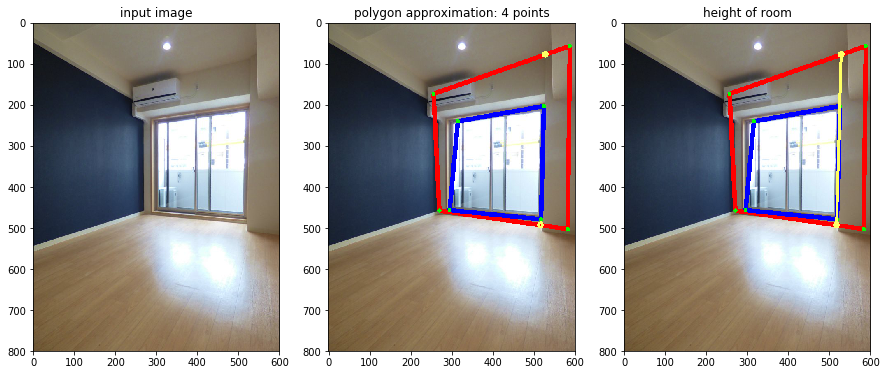

In [83]:
compute_height(125)

Height ratio is 1.3960
Room height is 2554.67mm if door height is 1830mm


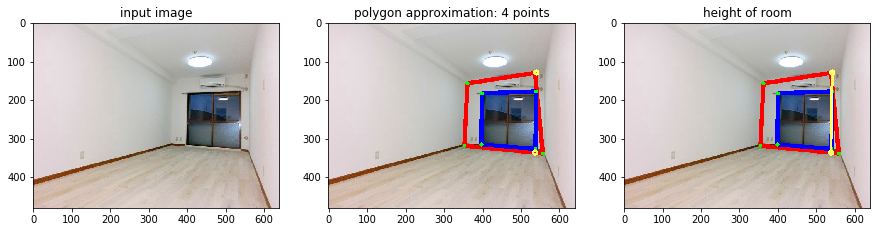

In [84]:
compute_height(107)

Height ratio is 1.1558
Room height is 2115.04mm if door height is 1830mm


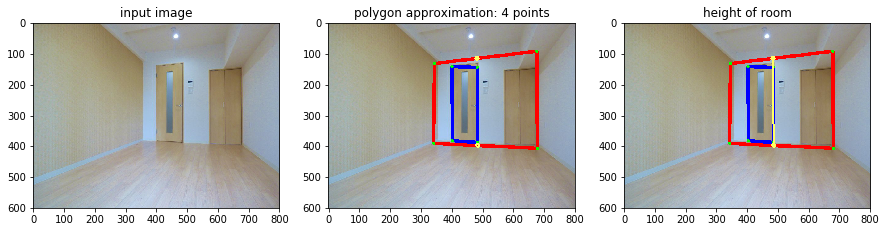

In [95]:
compute_height(293)

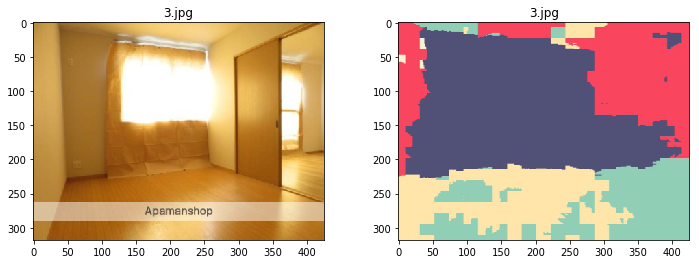

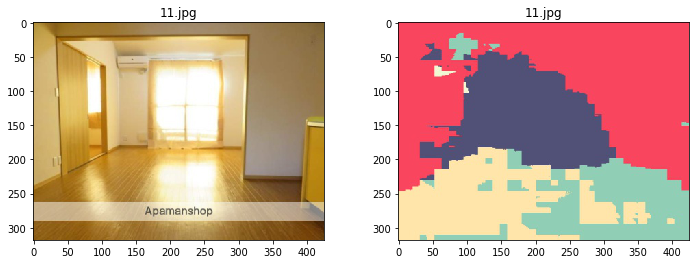

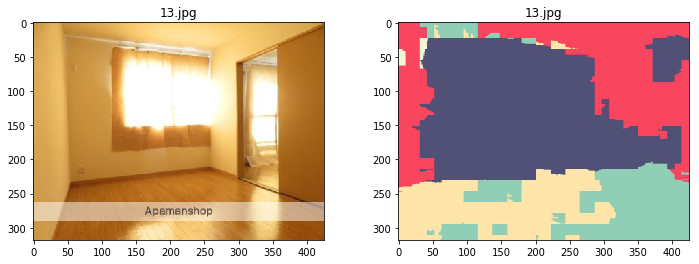

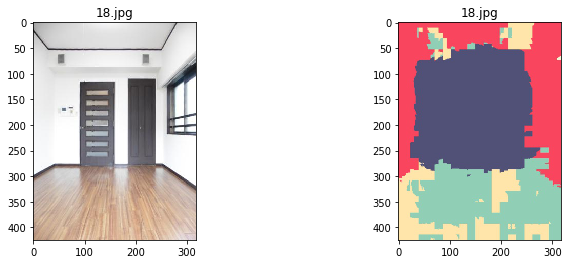

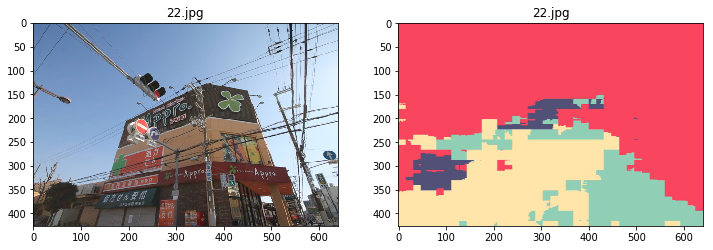

...

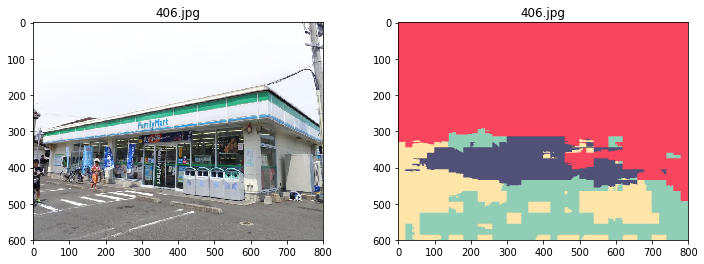

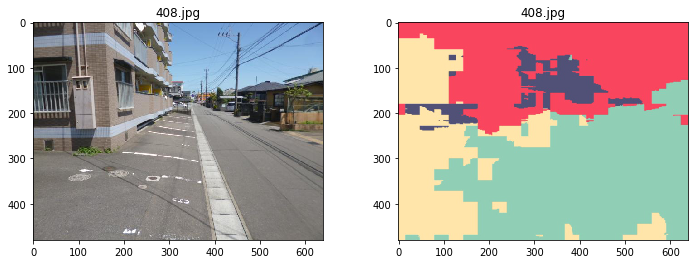

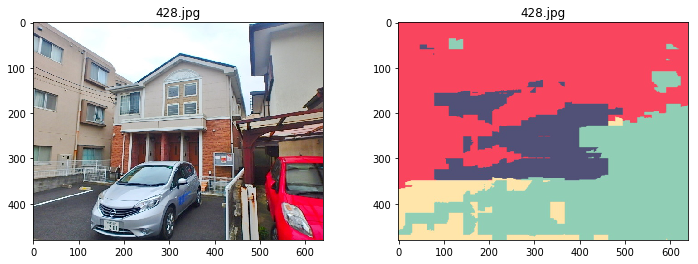

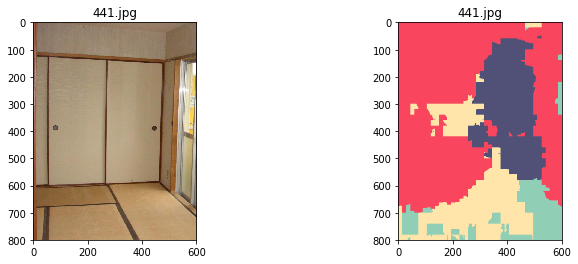

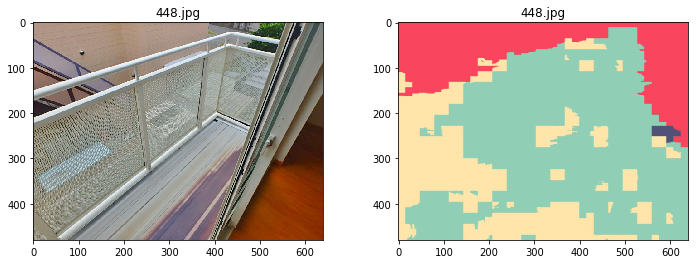

except: 466.jpg


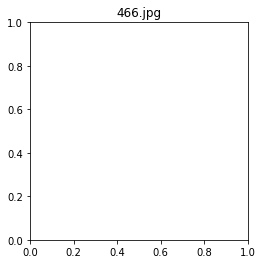

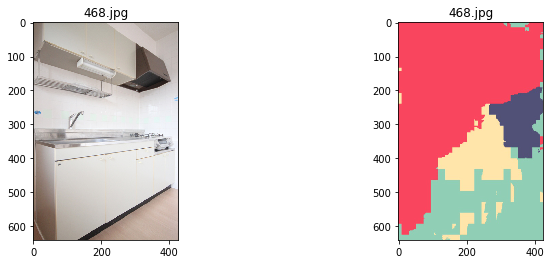

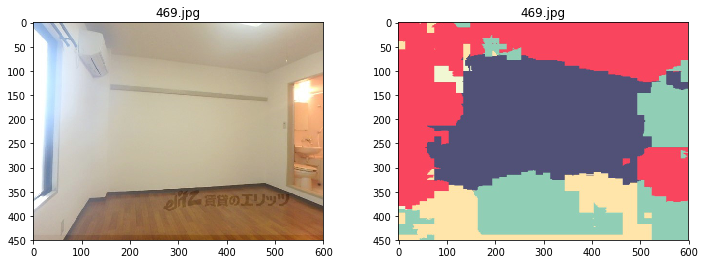

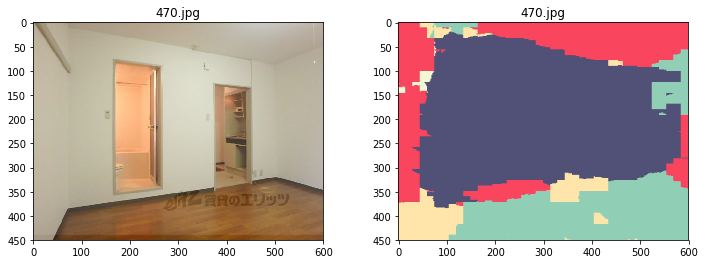

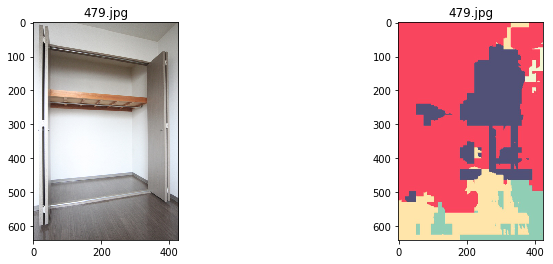

...

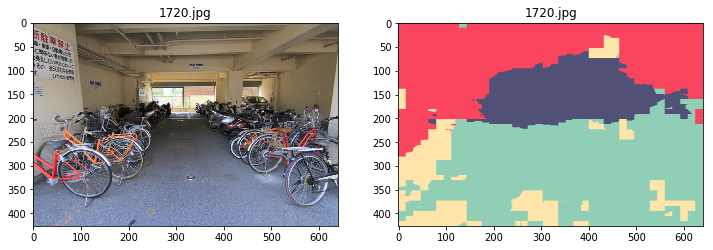

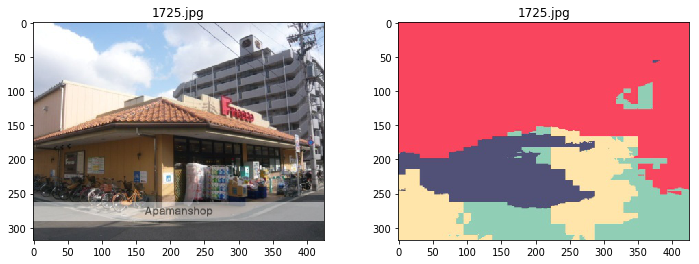

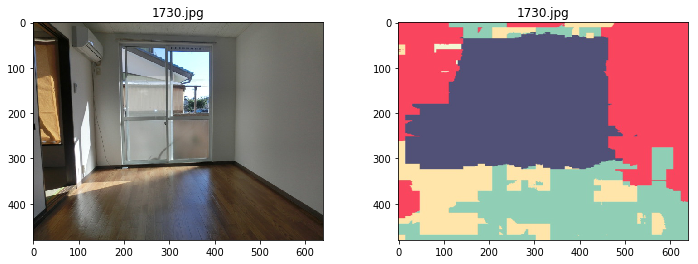

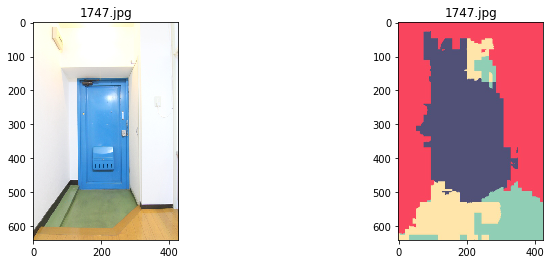

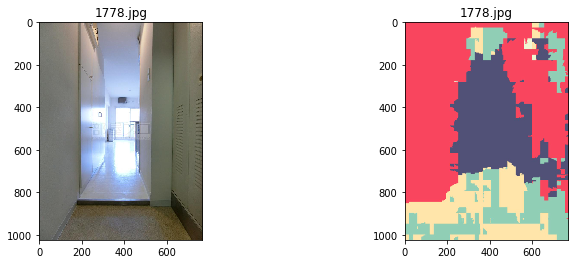

In [ ]:
din = Path('../data/img_type_test_in/')
dout = Path('../data/img_type_test_out/')
i = 0
while i < 3000:
    p = '%d.jpg' % i
    i += 1
    if p not in os.listdir(dout):
        continue
    try:
        plt.figure(figsize=(12, 4))
        plt.subplot(121)
        plt.title(p)
        plt.imshow(Image.open(din / p))
        plt.subplot(122)
        plt.title(p)
        plt.imshow(Image.open(dout / p))
        plt.show()
    except:
        print('except: %s' % p)